In [1]:
print("hello ip")

hello ip


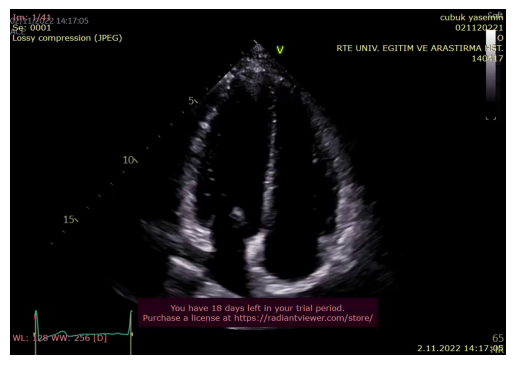

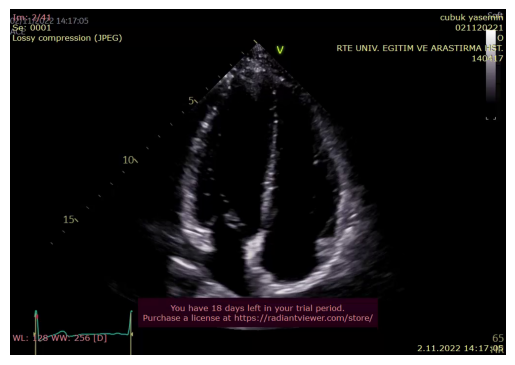

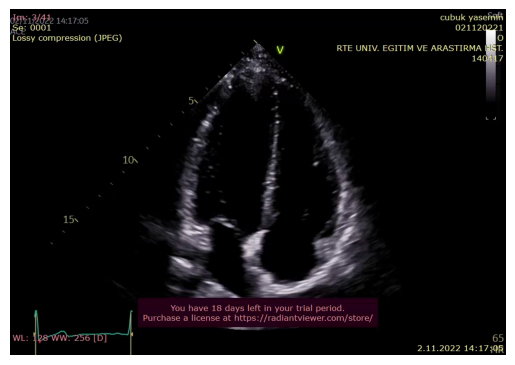

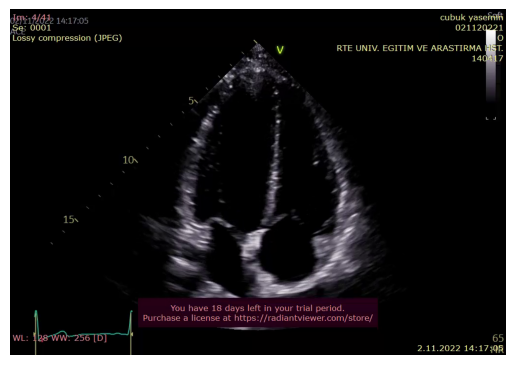

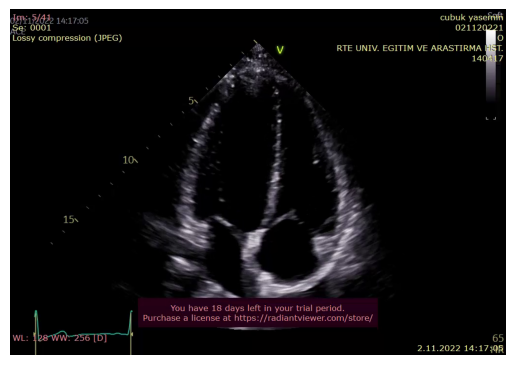

...

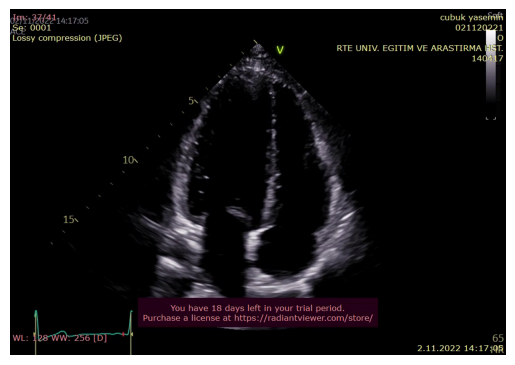

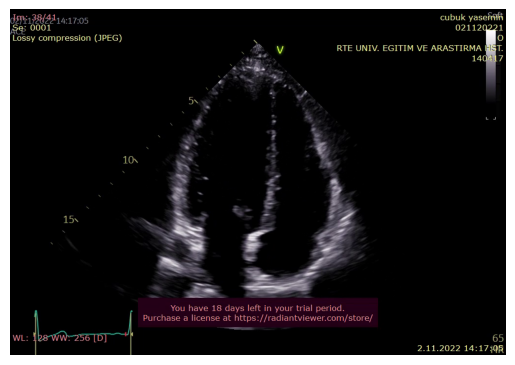

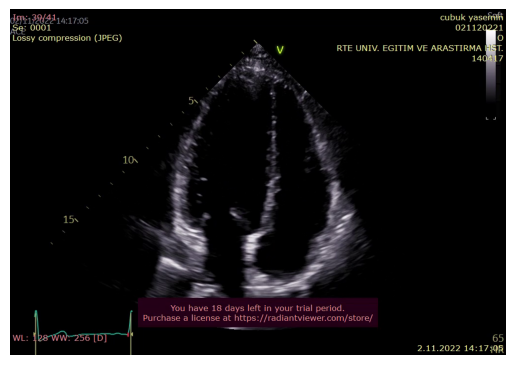

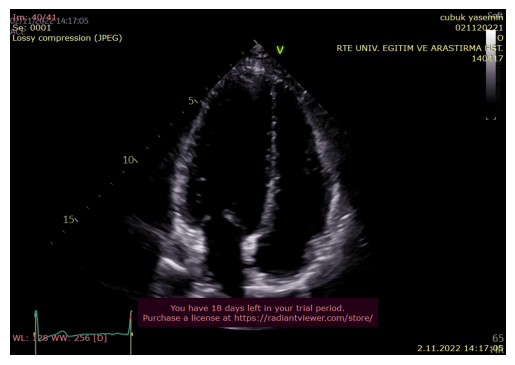

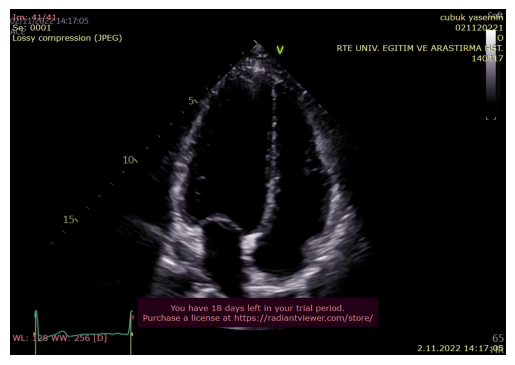

In [12]:
import cv2
import matplotlib.pyplot as plt

video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # BGR'den RGB'ye dönüştür
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Matplotlib ile kareyi göster
    plt.imshow(frame)
    plt.axis('off')
    plt.pause(0.01)

cap.release()
plt.close()


In [4]:
import cv2

video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
output_path = "output_edges.avi"

# Videoyu aç
cap = cv2.VideoCapture(video_path)

# Video yazıcı tanımla
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))), False)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Grayscale görüntüye dönüştür
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Kenar algılama
    edges = cv2.Canny(gray_frame, 100, 200)

    # Kenarları videoya yaz
    out.write(edges)

cap.release()
out.release()
print("Kenar algılama tamamlandı ve video kaydedildi: ", output_path)


Kenar algılama tamamlandı ve video kaydedildi:  output_edges.avi


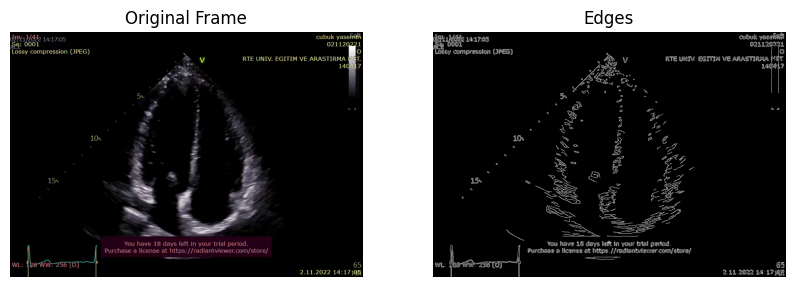

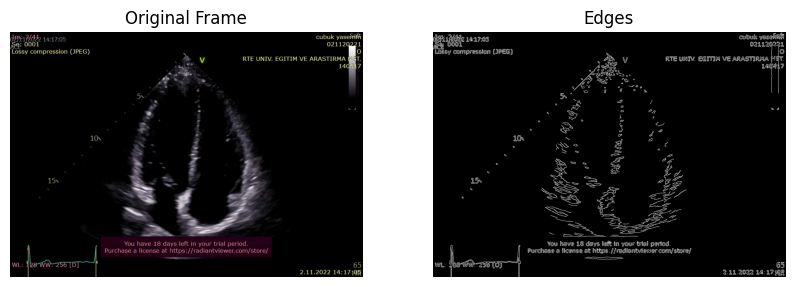

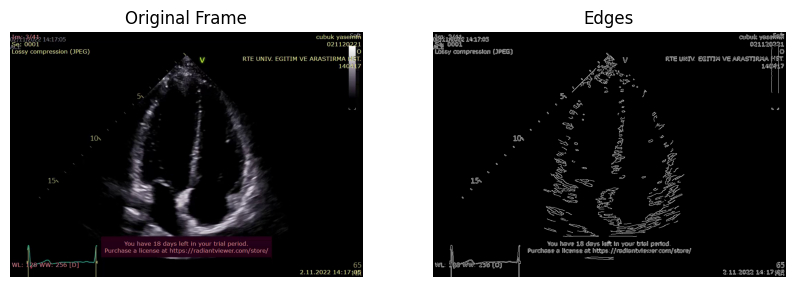

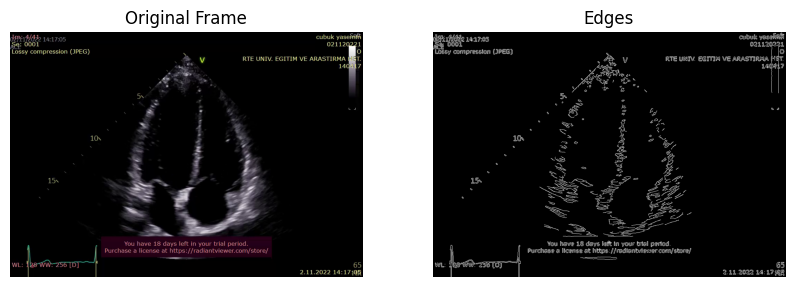

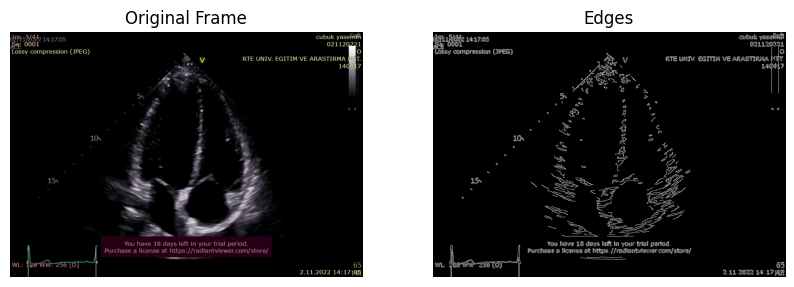

...

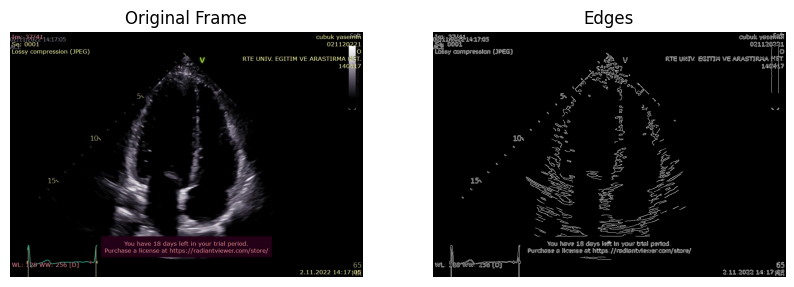

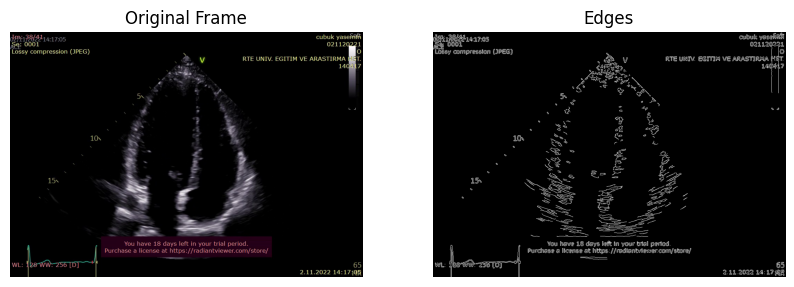

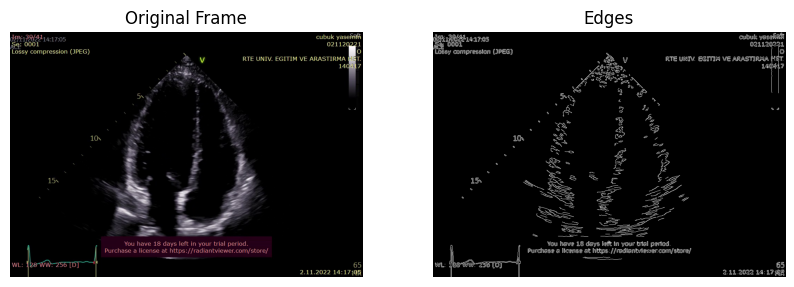

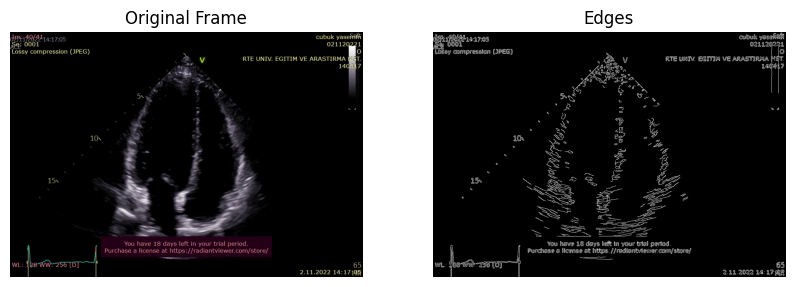

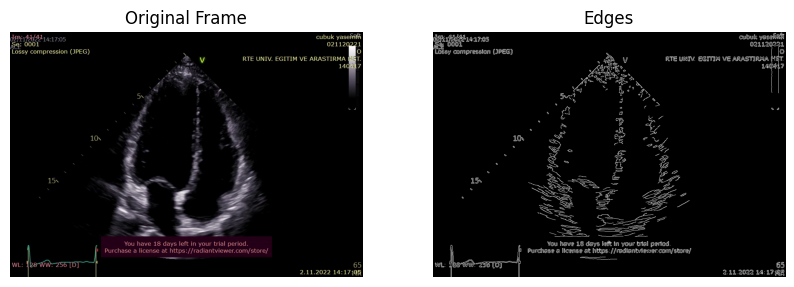

In [6]:
import cv2
import matplotlib.pyplot as plt

# Video dosyasının yolunu belirt
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"

# Videoyu aç
cap = cv2.VideoCapture(video_path)

# Kareleri işle ve göster
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:  # Video bittiğinde çık
        break

    # Grayscale (gri tonlama) görüntüye dönüştür
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Kenar algılama
    edges = cv2.Canny(gray_frame, 100, 200)

    # Görüntüyü Matplotlib ile göster
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.title("Original Frame")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(edges, cmap="gray")
    plt.title("Edges")
    plt.axis("off")

    plt.show()
    plt.pause(0.001)  # Görüntüyü hızlıca güncelle

cap.release()
plt.close()


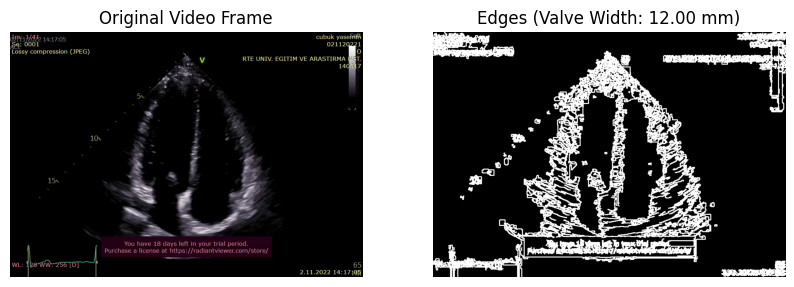

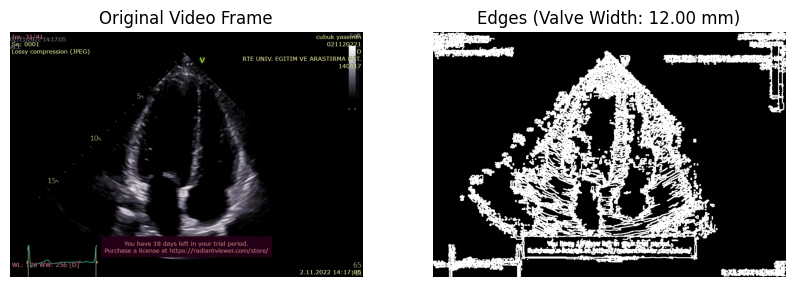

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Video dosyasını yükle
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
cap = cv2.VideoCapture(video_path)

# Video kaydetmek için ayarlar
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter("output_edges.avi", fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Pikselden milimetreye dönüşüm oranı (örnek: 1 piksel = 0.1 mm)
pixel_to_mm_ratio = 0.1

frame_count = 0  # Görselleştirilecek kare sayısını sınırlamak için sayaç

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Gri tonlamaya çevir
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Görüntüyü iyileştirme (kontrast artırma)
    enhanced_frame = cv2.equalizeHist(gray_frame)

    # Otsu ile eşik değerini bul ve Canny kenar algılama uygula
    _, otsu_thresh = cv2.threshold(enhanced_frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    if isinstance(otsu_thresh, (int, float)):
        edges = cv2.Canny(enhanced_frame, otsu_thresh * 0.5, otsu_thresh)
    else:
        # Manuel eşik değerleriyle Canny kenar algılama
        edges = cv2.Canny(enhanced_frame, 50, 150)

    # Kenarları genişletmek için morfolojik işlemler uygula
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    edges_dilated = cv2.dilate(edges, kernel, iterations=1)

    # Kenarların toplam piksel uzunluğunu hesapla
    edge_length = np.sum(edges_dilated > 0)

    # Kalp kapağı genişliğini tahmin et
    valve_width_pixels = 120  # Varsayılan piksel genişliği
    valve_width_mm = valve_width_pixels * pixel_to_mm_ratio

    # Video çıktısına kaydet
    out.write(cv2.cvtColor(edges_dilated, cv2.COLOR_GRAY2BGR))

    # Görselleştirmek için her 30 karede bir görüntü göster
    if frame_count % 30 == 0:
        plt.figure(figsize=(10, 5))

        # Orijinal video karesi
        plt.subplot(1, 2, 1)
        plt.title("Original Video Frame")
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        # Kenarlar
        plt.subplot(1, 2, 2)
        plt.title(f"Edges (Valve Width: {valve_width_mm:.2f} mm)")
        plt.imshow(edges_dilated, cmap="gray")
        plt.axis("off")

        plt.show()

    frame_count += 1

    # Döngüyü erken sonlandırmak için bir sınır
    if frame_count > 200:  # İlk 200 kareyi işle
        break

# Tüm kaynakları serbest bırak
cap.release()
out.release()
plt.close()


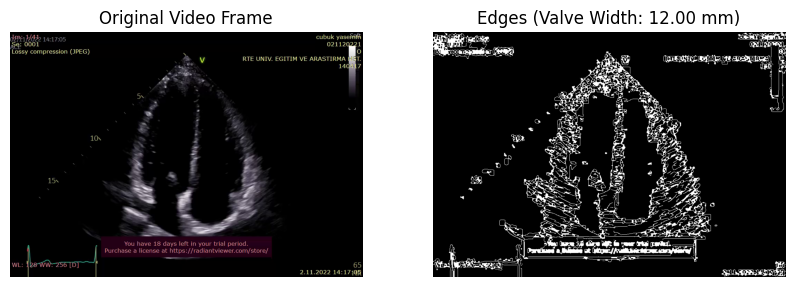

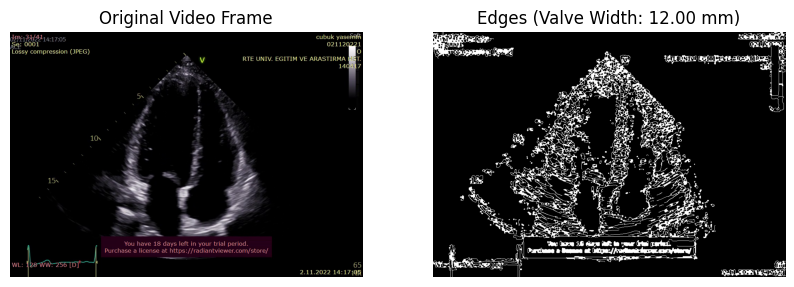

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Video dosyasını yükle
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
cap = cv2.VideoCapture(video_path)

# Pikselden milimetreye dönüşüm oranı (örnek: 1 piksel = 0.1 mm)
pixel_to_mm_ratio = 0.1

frame_count = 0  # Görselleştirilecek kare sayısını sınırlamak için sayaç

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Gri tonlamaya çevir
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Gürültüyü azaltmak için Gaussian Blur uygula
    blurred_frame = cv2.GaussianBlur(gray_frame, (5, 5), 0)

    # Görüntüyü iyileştirme (kontrast artırma)
    enhanced_frame = cv2.equalizeHist(blurred_frame)

    # Otsu ile eşik değerini bul
    otsu_thresh_value, _ = cv2.threshold(enhanced_frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Canny kenar algılama uygula (Otsu eşik değerlerini kullanarak)
    lower_threshold = max(0, 0.5 * otsu_thresh_value)  # Alt eşik
    upper_threshold = min(255, otsu_thresh_value)      # Üst eşik
    edges = cv2.Canny(enhanced_frame, lower_threshold, upper_threshold)

    # Kenarları temizlemek için morfolojik işlemler uygula
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

    # Kenarların toplam piksel uzunluğunu hesapla
    edge_length = np.sum(edges_cleaned > 0)

    # Kalp kapağı genişliğini tahmin et
    valve_width_pixels = 120  # Varsayılan piksel genişliği
    valve_width_mm = valve_width_pixels * pixel_to_mm_ratio

    # Görselleştirmek için her 30 karede bir görüntü göster
    if frame_count % 30 == 0:
        plt.figure(figsize=(10, 5))

        # Orijinal video karesi
        plt.subplot(1, 2, 1)
        plt.title("Original Video Frame")
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        # Kenarlar (Gürültüsü azaltılmış)
        plt.subplot(1, 2, 2)
        plt.title(f"Edges (Valve Width: {valve_width_mm:.2f} mm)")
        plt.imshow(edges_cleaned, cmap="gray")  # Gürültüsü azaltılmış kenarlar
        plt.axis("off")

        plt.show()

    frame_count += 1

    # Döngüyü erken sonlandırmak için bir sınır
    if frame_count > 200:  # İlk 200 kareyi işle
        break

# Tüm kaynakları serbest bırak
cap.release()
plt.close()


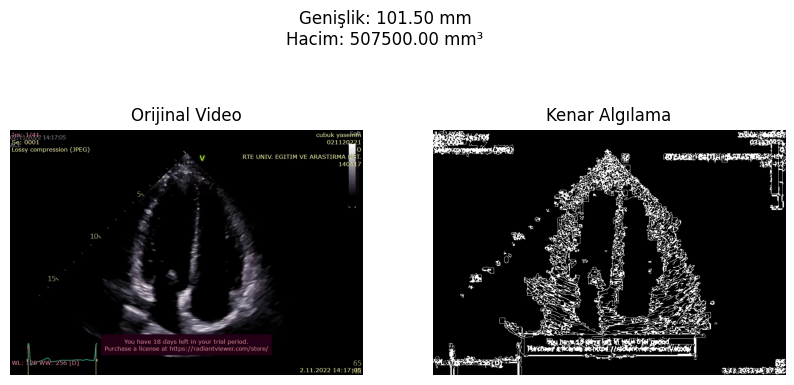

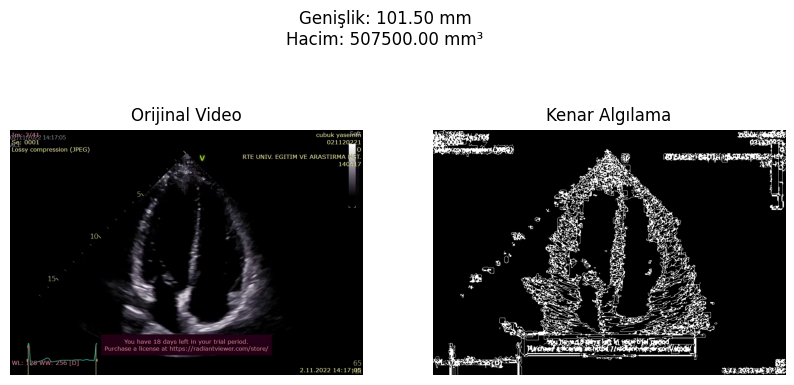

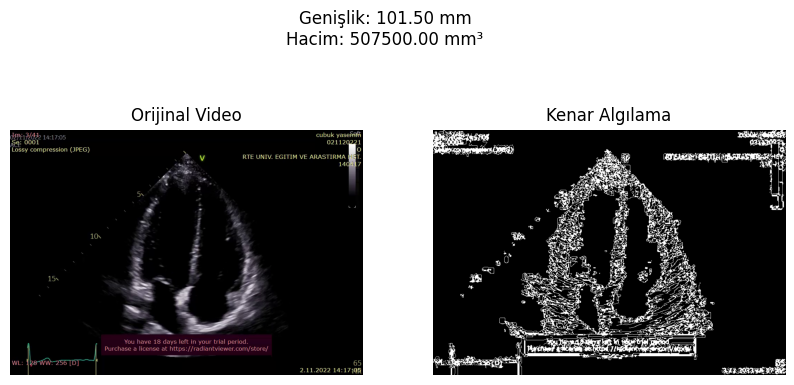

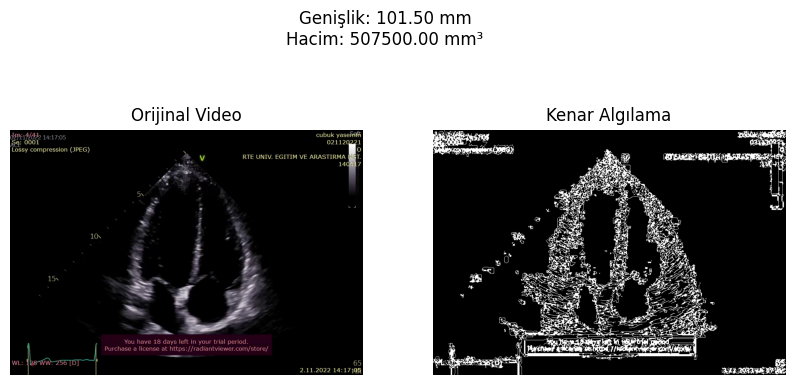

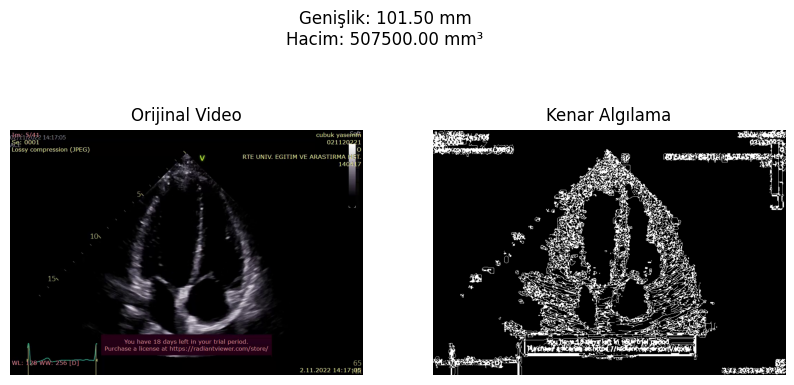

...

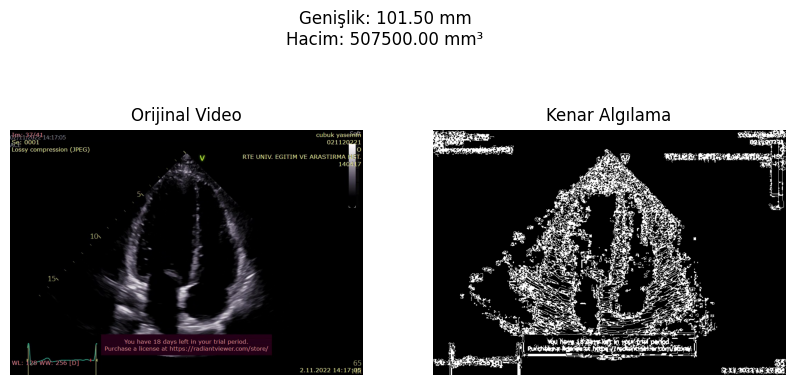

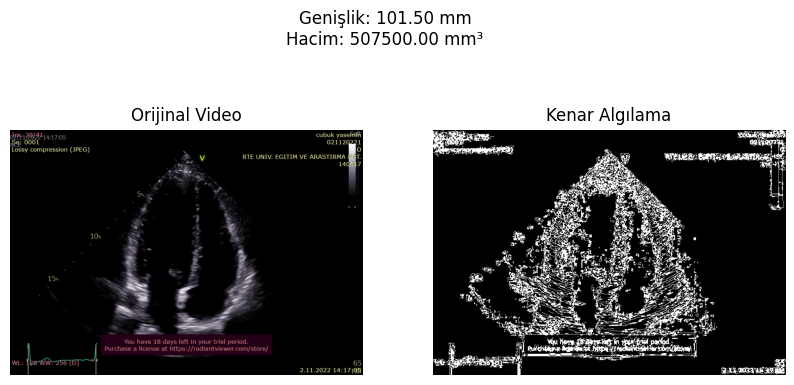

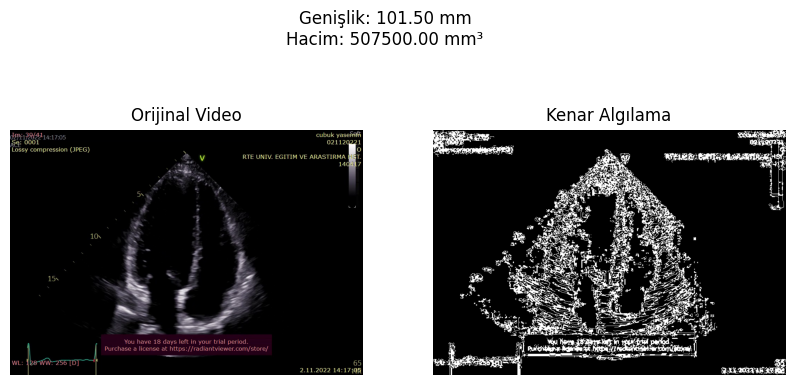

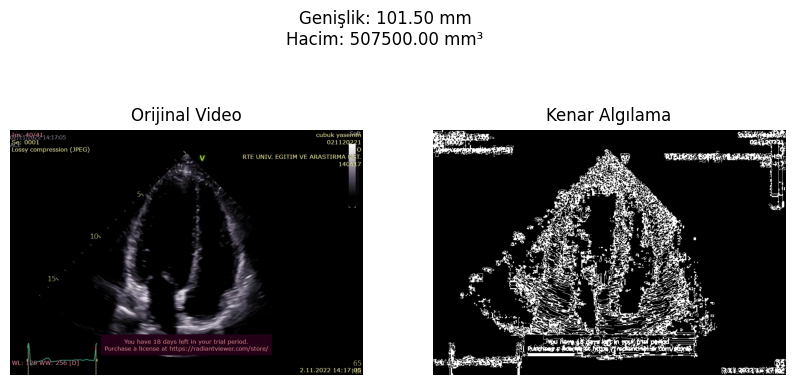

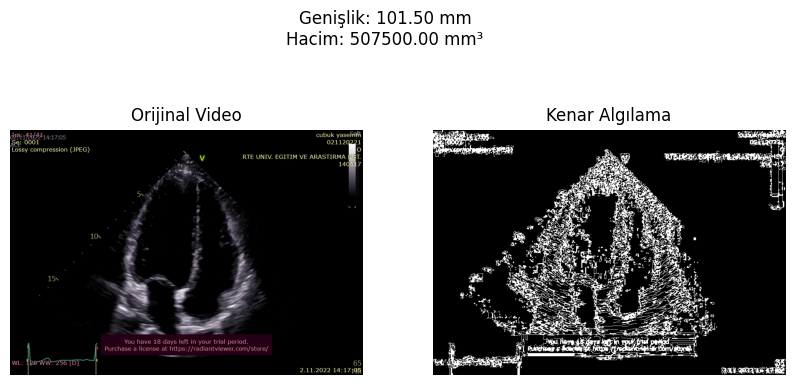

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_volume(length_mm, width_mm, depth_mm):
    """
    Kalbin hacmini hesaplar (mm^3).
    """
    return length_mm * width_mm * depth_mm

def process_video(video_path, mm_per_pixel):
    """
    Ekokardiyografi videosunu işleyerek kenar algılama, genişlik hesaplama ve hacim tahmini yapar.
    """
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print("Video açılamadı!")
        return

    while cap.isOpened():
        ret, frame = cap.read()

        if not ret:
            break

        # Grayscale çevir
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Histogram eşitleme ve görüntü iyileştirme
        enhanced_frame = cv2.equalizeHist(gray_frame)

        # Otsu ile eşik değerini bul ve Canny kenar algılama uygula
        otsu_thresh_val, _ = cv2.threshold(enhanced_frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        threshold1 = max(0, 0.5 * otsu_thresh_val)  # Alt eşik değeri
        threshold2 = min(255, otsu_thresh_val)      # Üst eşik değeri

        edges = cv2.Canny(enhanced_frame.astype('uint8'), threshold1, threshold2)

        # Kenarları temizlemek için morfolojik işlemler uygula (genişletme kaldırıldı)
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        edges_cleaned = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)  # Closing işlemi sadece boşlukları kapatır

        # Piksel cinsinden genişlik hesapla
        horizontal_projection = np.sum(edges_cleaned, axis=0)
        non_zero_indices = np.where(horizontal_projection > 0)[0]

        if len(non_zero_indices) > 1:
            valve_width_pixels = non_zero_indices[-1] - non_zero_indices[0]
        else:
            valve_width_pixels = 0

        valve_width_mm = valve_width_pixels * mm_per_pixel

        # Kalp hacmi tahmini için örnek derinlik ve uzunluk değerleri (mm cinsinden)
        heart_length_mm = 100  # Örnek uzunluk değeri
        heart_depth_mm = 50    # Örnek derinlik değeri

        heart_volume_mm3 = calculate_volume(heart_length_mm, valve_width_mm, heart_depth_mm)

        # Görselleştirme
        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.title("Orijinal Video")
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.title("Kenar Algılama")
        plt.imshow(edges_cleaned, cmap="gray")
        plt.axis("off")

        plt.suptitle(f"Genişlik: {valve_width_mm:.2f} mm\nHacim: {heart_volume_mm3:.2f} mm³")
        plt.show()

    cap.release()

# Parametreler
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
mm_per_pixel = 0.1  # Pikselin mm'ye dönüşüm oranı

process_video(video_path, mm_per_pixel)


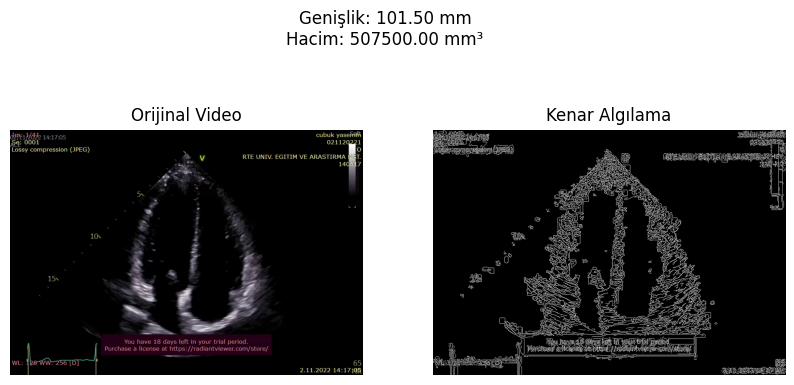

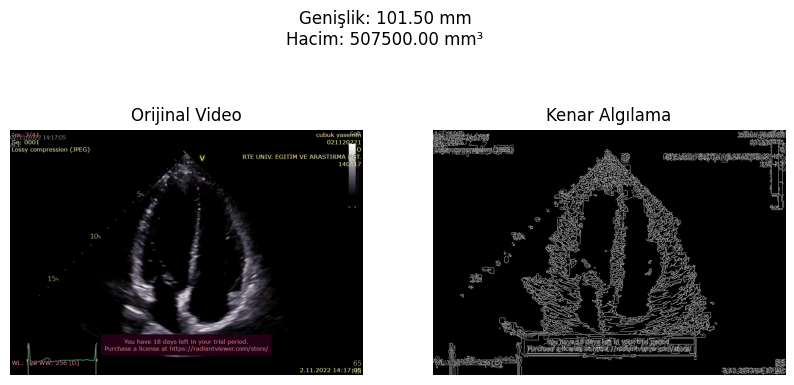

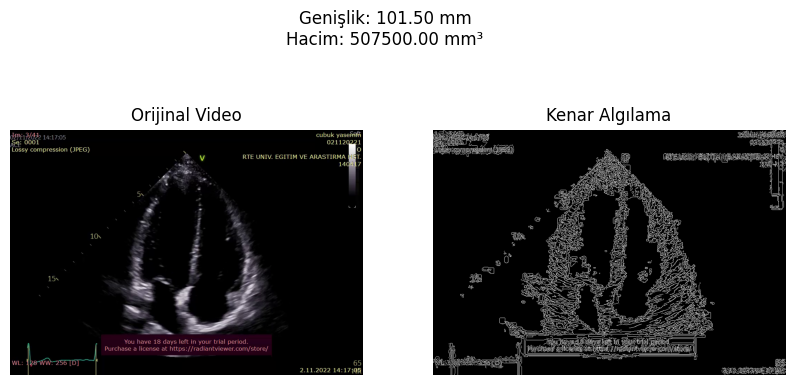

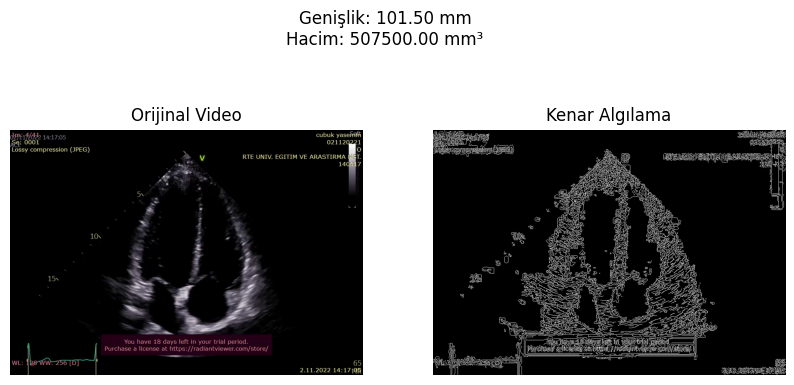

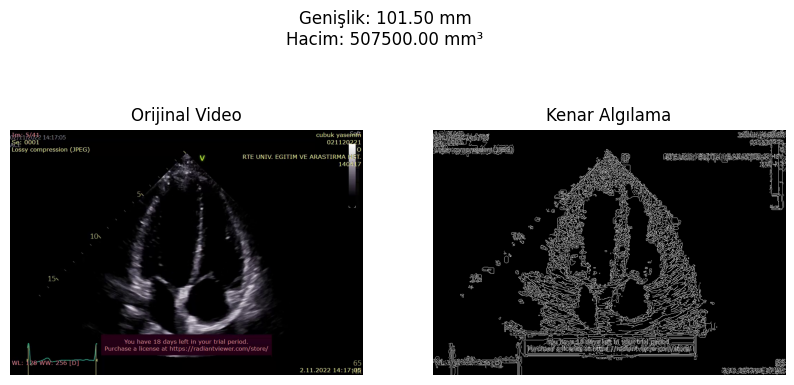

...

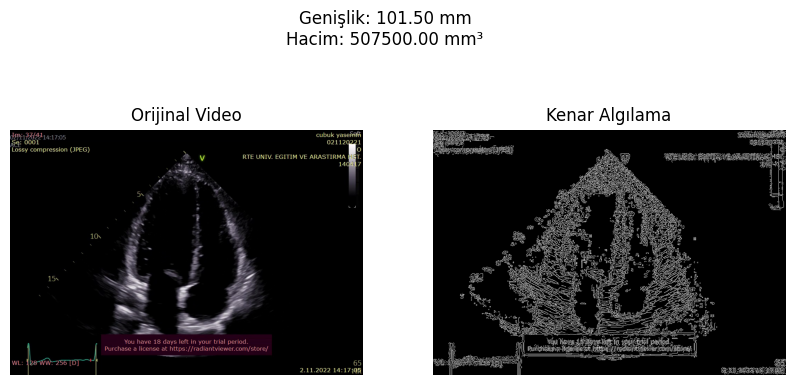

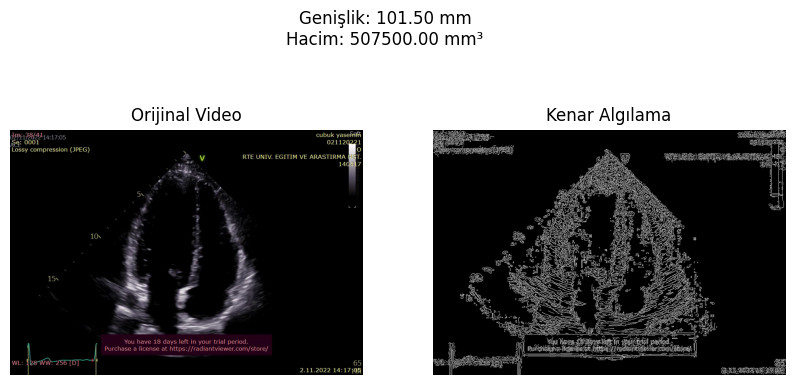

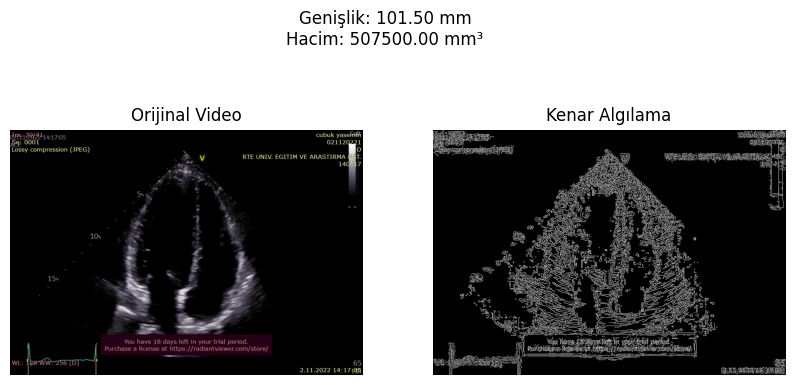

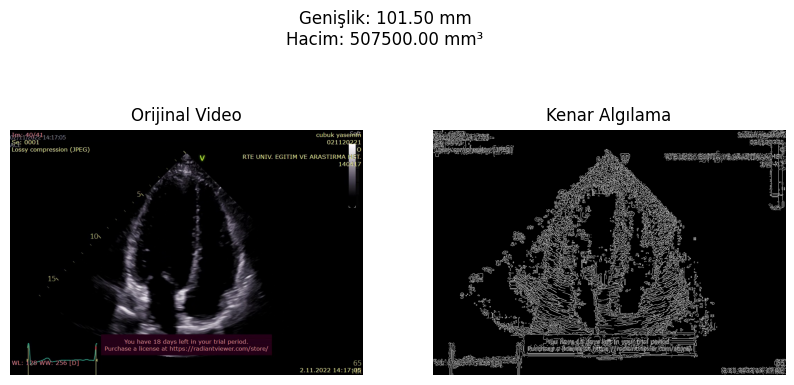

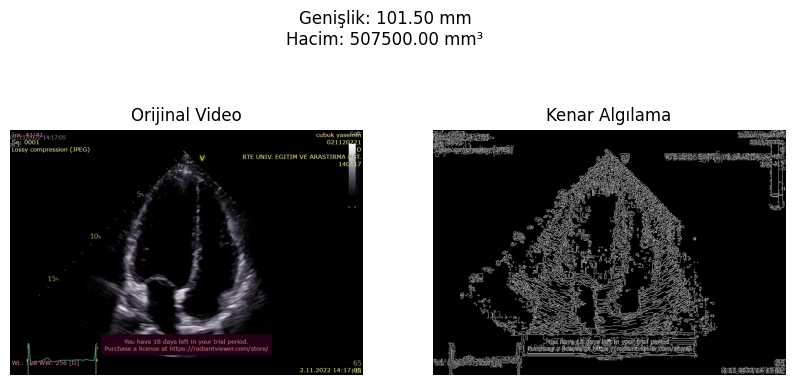

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_volume(length_mm, width_mm, depth_mm):
    """
    Kalbin hacmini hesaplar (mm^3).
    """
    return length_mm * width_mm * depth_mm

def process_video(video_path, mm_per_pixel):
    """
    Ekokardiyografi videosunu işleyerek kenar algılama, genişlik hesaplama ve hacim tahmini yapar.
    """
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print("Video açılamadı!")
        return

    while cap.isOpened():
        ret, frame = cap.read()

        if not ret:
            break

        # Grayscale çevir
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Histogram eşitleme ve görüntü iyileştirme
        enhanced_frame = cv2.equalizeHist(gray_frame)

        # Otsu ile eşik değerini bul ve Canny kenar algılama uygula
        otsu_thresh_val, _ = cv2.threshold(enhanced_frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        threshold1 = max(0, 0.5 * otsu_thresh_val)  # Alt eşik değeri
        threshold2 = min(255, otsu_thresh_val)      # Üst eşik değeri

        edges = cv2.Canny(enhanced_frame.astype('uint8'), threshold1, threshold2)

        # Kenarları olduğu gibi bırak, herhangi bir genişletme yapma

        # Piksel cinsinden genişlik hesapla
        horizontal_projection = np.sum(edges, axis=0)
        non_zero_indices = np.where(horizontal_projection > 0)[0]

        if len(non_zero_indices) > 1:
            valve_width_pixels = non_zero_indices[-1] - non_zero_indices[0]
        else:
            valve_width_pixels = 0

        valve_width_mm = valve_width_pixels * mm_per_pixel

        # Kalp hacmi tahmini için örnek derinlik ve uzunluk değerleri (mm cinsinden)
        heart_length_mm = 100  # Örnek uzunluk değeri
        heart_depth_mm = 50    # Örnek derinlik değeri

        heart_volume_mm3 = calculate_volume(heart_length_mm, valve_width_mm, heart_depth_mm)

        # Görselleştirme
        plt.figure(figsize=(10, 5))

        plt.subplot(1, 2, 1)
        plt.title("Orijinal Video")
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.title("Kenar Algılama")
        plt.imshow(edges, cmap="gray")
        plt.axis("off")

        plt.suptitle(f"Genişlik: {valve_width_mm:.2f} mm\nHacim: {heart_volume_mm3:.2f} mm³")
        plt.show()

    cap.release()

# Parametreler
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
mm_per_pixel = 0.1  # Pikselin mm'ye dönüşüm oranı

process_video(video_path, mm_per_pixel)

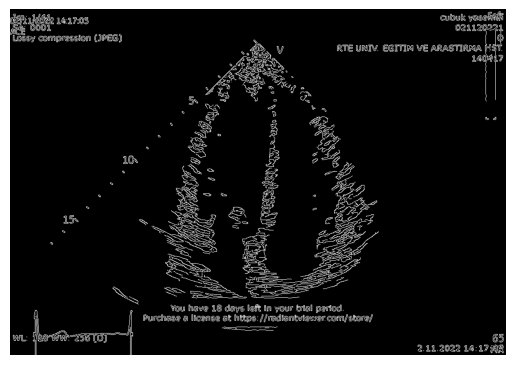

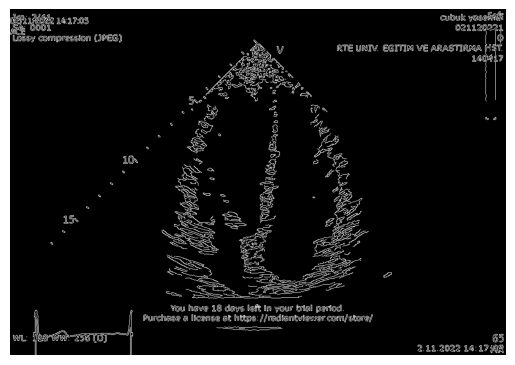

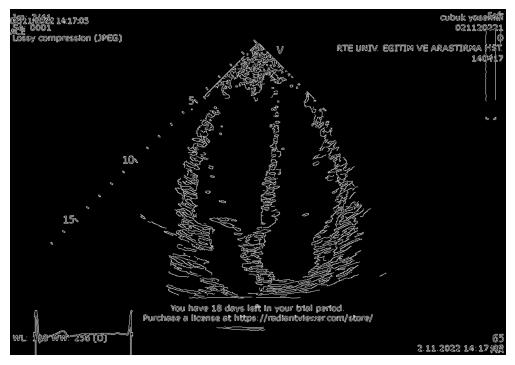

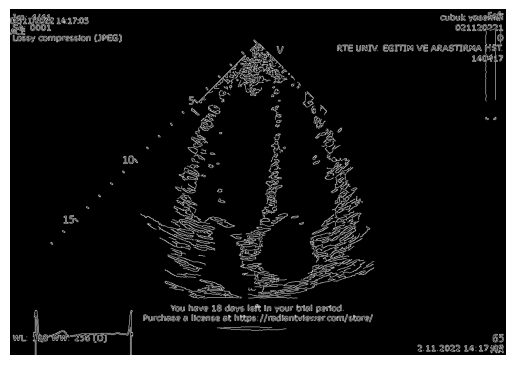

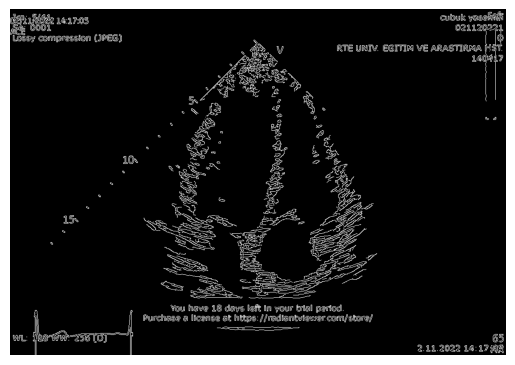

...

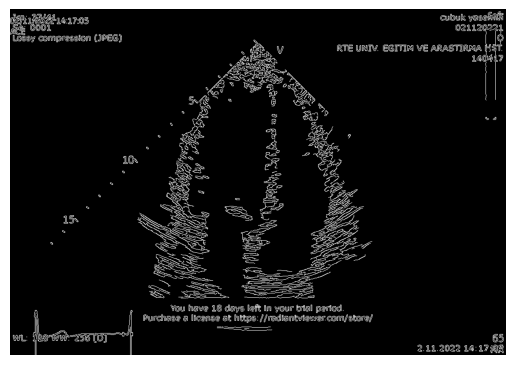

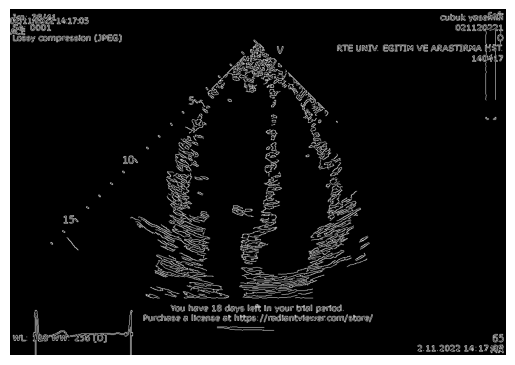

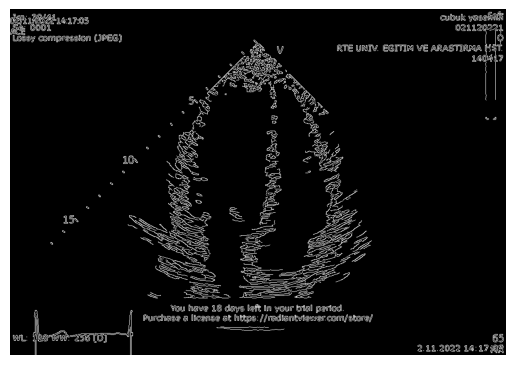

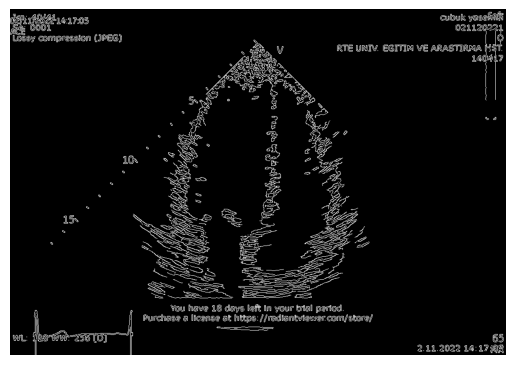

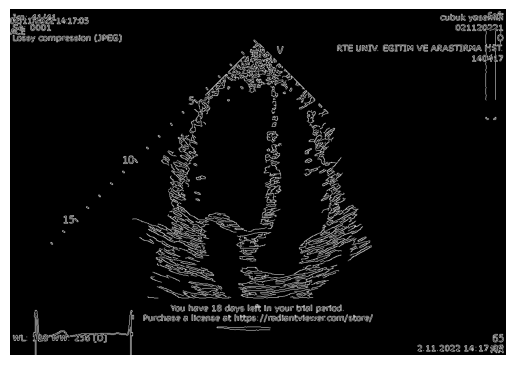

In [15]:
import cv2
import matplotlib.pyplot as plt

# Video yolu
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Grayscale'e dönüştür
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Canny ile kenarları tespit et
    edges = cv2.Canny(gray, threshold1=50, threshold2=150)

    # Matplotlib ile kenar görüntüsünü göster
    plt.imshow(edges, cmap='gray')
    plt.axis('off')
    plt.pause(0.01)

cap.release()
plt.close()


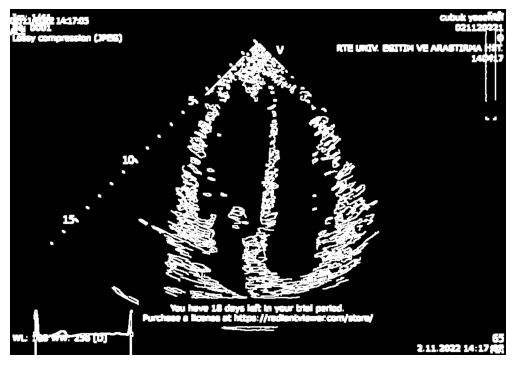

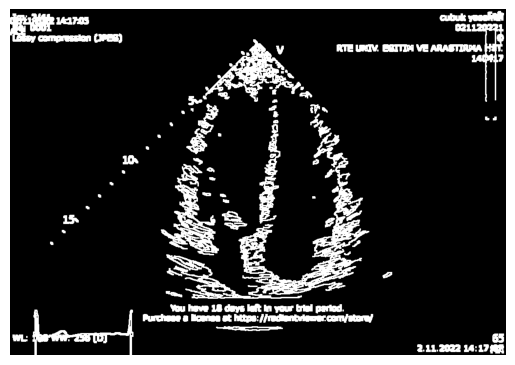

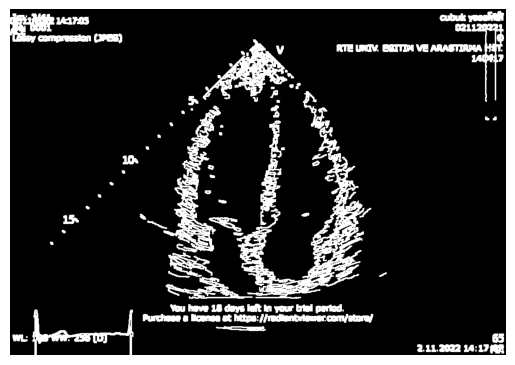

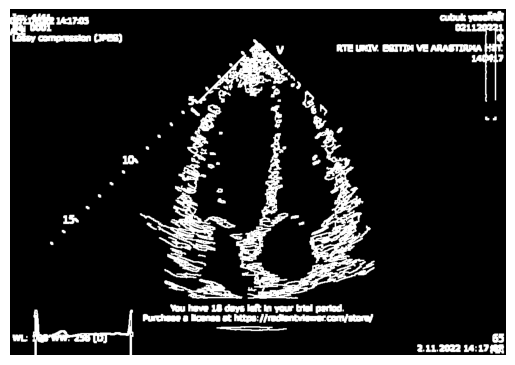

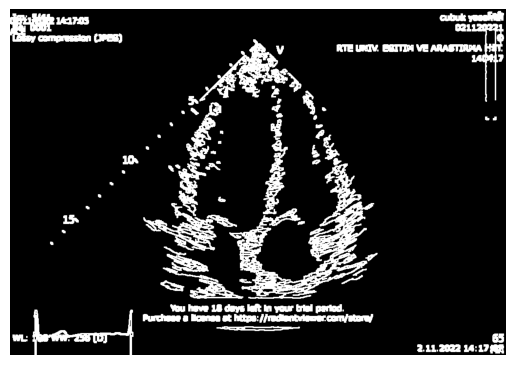

...

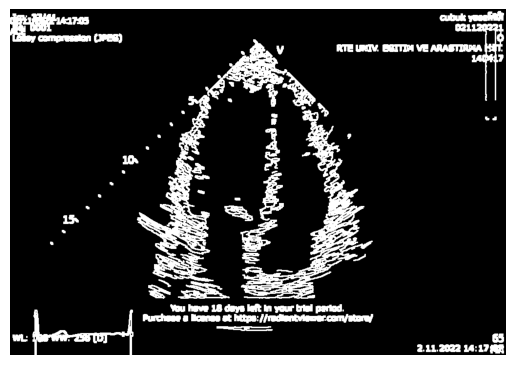

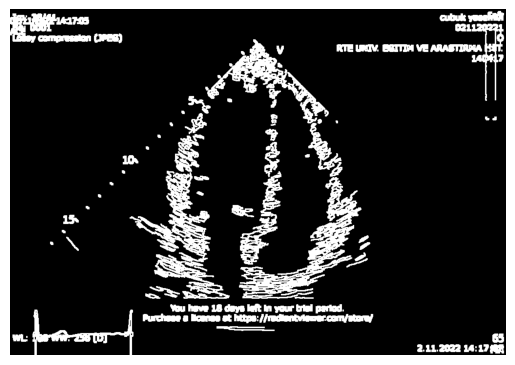

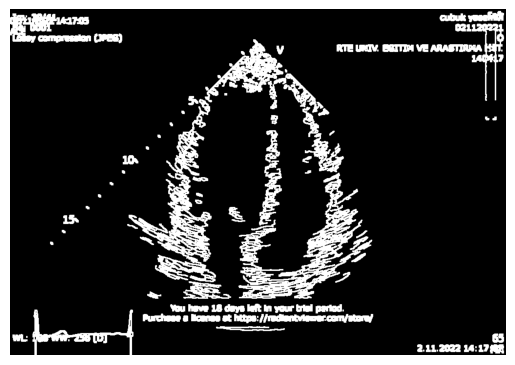

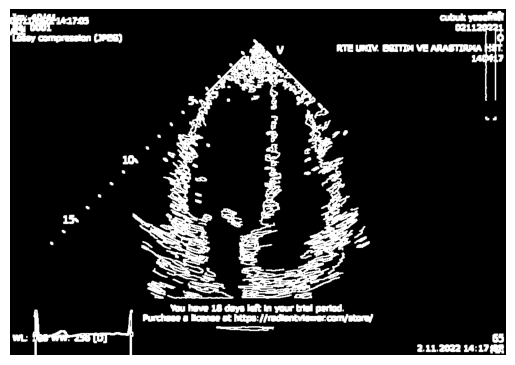

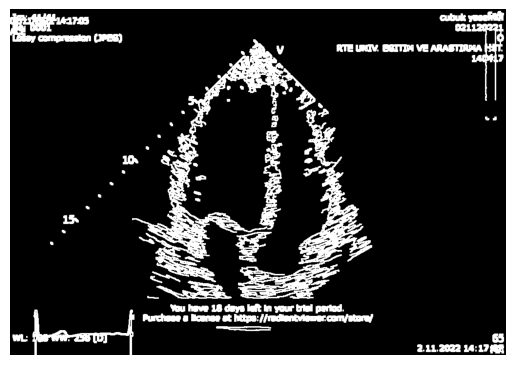

In [16]:
import cv2
import matplotlib.pyplot as plt

# Video yolu
video_path = "/workspaces/nesne_yonelimli/heart/4_5800996453060974223.mp4"
cap = cv2.VideoCapture(video_path)

# Genişletme için çekirdek (kernel) tanımı
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))  # 3x3 boyutlu bir çekirdek

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Grayscale'e dönüştür
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Canny ile kenarları tespit et
    edges = cv2.Canny(gray, threshold1=50, threshold2=150)

    # Kenarları genişlet (kalınlaştır)
    dilated_edges = cv2.dilate(edges, kernel, iterations=1)

    # Matplotlib ile kenar görüntüsünü göster
    plt.imshow(dilated_edges, cmap='gray')
    plt.axis('off')
    plt.pause(0.01)

cap.release()
plt.close()
